# 05 - Support Vector Machines: intuición

![](images/portada_nb_FAV.png)

## Módulo 6 - Aprendizaje de máquina supervisado
### Profesor: M.Sc. Favio Vázquez

## Modelos lineales

In [1]:
from imports import *

In [2]:
from sklearn.datasets import make_blobs

X,y = make_blobs(centers=4, random_state=8)
y = y % 2

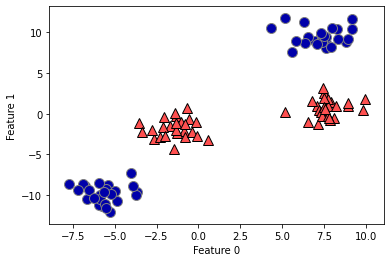

In [3]:
mglearn.discrete_scatter(X[:, 0], X[:, 1], y)
plt.xlabel("Feature 0")
plt.ylabel("Feature 1")
plt.show()

In [4]:
from sklearn.svm import LinearSVC
linear_svm = LinearSVC().fit(X,y)

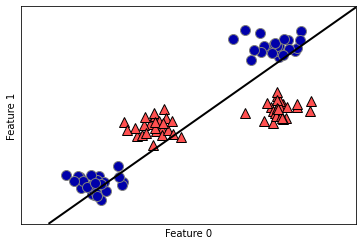

In [5]:
mglearn.plots.plot_2d_separator(linear_svm, X)
mglearn.discrete_scatter(X[:, 0], X[:, 1], y)
plt.xlabel("Feature 0")
plt.ylabel("Feature 1")
plt.show()

In [6]:
# Modificar los datos agregando un nuevo feature 

X_new = np.hstack([X, X[:, 1:] ** 2])

Text(0.5, 0, 'feature1 ** 2')

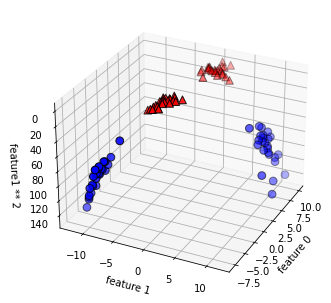

In [7]:
from mpl_toolkits.mplot3d import Axes3D, axes3d

figure = plt.figure()

ax = Axes3D(figure, elev=-152, azim=-26)
mask = y == 0

ax.scatter(X_new[mask, 0], X_new[mask, 1], X_new[mask,2], c="b",
           cmap=mglearn.cm2, s=60, edgecolor="k")
ax.scatter(X_new[~mask, 0], X_new[~mask, 1], X_new[~mask,2], c="r",
           marker="^",cmap=mglearn.cm2, s=60, edgecolor="k")
ax.set_xlabel("feature 0")
ax.set_ylabel("feature 1")
ax.set_zlabel("feature1 ** 2")

In [8]:
linear_svm_3d = LinearSVC().fit(X_new, y)

In [9]:
coef, intercept = linear_svm_3d.coef_.ravel(), linear_svm_3d.intercept_

Text(0.5, 0, 'feature1 ** 2')

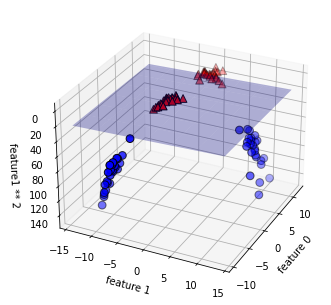

In [10]:
figure = plt.figure()
ax = Axes3D(figure, elev=-152, azim=-26)

xx = np.linspace(X_new[:, 0].min() - 2, X_new[:,0].max() +2, 50)
yy = np.linspace(X_new[:, 1].min() - 2, X_new[:,1].max() +2, 50)

XX, YY = np.meshgrid(xx,yy)

ZZ = (coef[0] * XX + coef[1] * YY + intercept / -coef[2])
ax.plot_surface(XX,YY,ZZ, rstride=8, cstride=8, alpha=0.3)
mask = y == 0

ax.scatter(X_new[mask, 0], X_new[mask, 1], X_new[mask,2], c="b",
           cmap=mglearn.cm2, s=60, edgecolor="k")
ax.scatter(X_new[~mask, 0], X_new[~mask, 1], X_new[~mask,2], c="r",
           marker="^",cmap=mglearn.cm2, s=60, edgecolor="k")
ax.set_xlabel("feature 0")
ax.set_ylabel("feature 1")
ax.set_zlabel("feature1 ** 2")

Text(0, 0.5, 'Feature 1')

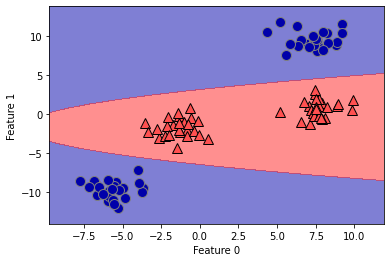

In [11]:
ZZ = YY ** 2
dec = linear_svm_3d.decision_function(np.c_[XX.ravel(), YY.ravel(), 
                                            ZZ.ravel()])
plt.contourf(XX,YY, dec.reshape(XX.shape), levels=[dec.min(), 0, 
                                                   dec.max()],
            cmap=mglearn.cm2, alpha=0.5)
mglearn.discrete_scatter(X[:, 0], X[:, 1], y)
plt.xlabel("Feature 0")
plt.ylabel("Feature 1")

## Support Vector Machines - teoría básica

Supongamos que tenemos un conjunto de puntos que pertenecen a dos clases separadas. Queremos separar esas dos clases de una manera que nos permita asignar correctamente cualquier punto nuevo futuro a una clase u otra.

El algoritmo SVM logra eso al encontrar un hiperplano que separa las dos clases con el mayor margen posible. Los puntos que terminan en los márgenes se conocen como vectores de soporte.

A veces, sin embargo, puede que no sea posible separar las dos clases correctamente, o puede tener algunos valores atípicos que caen dentro del margen. Cualquiera de estos puntos mal clasificados o dentro del margen sería penalizado. Aquí es donde entra el valor de "holgura", denotado por una letra griega $\xi$ (xi, pronunciada "ksi"). Puede ignorarlo por ahora, pero será más relevante cuando analicemos los support vector regressors.

![](images/svm1.png)

En el gráfico anterior, tenemos una clase de puntos azules y una clase de puntos verdes. Probamos algunos hiperplanos diferentes para separar los puntos con los siguientes resultados:

- H1 no pudo separar correctamente las clases. Por tanto, no es una solución viable.
- H2 separó las clases correctamente, pero el margen entre el hiperplano y el punto más cercano es bastante pequeño. Por lo tanto, existe una alta probabilidad de clasificar incorrectamente cualquier punto nuevo futuro. Por ejemplo, el algoritmo asignará el nuevo punto gris (x1 = 3, x2 = 3.6) a la clase verde cuando sea obvio que debería pertenecer a la clase azul.
- H3 separa las dos clases con el margen más alto posible, lo que hace que el modelo sea mucho más robusto. Esto asegura que es más probable que asignemos nuevos puntos futuros a la clase correcta correctamente. Tenga en cuenta que tenemos un valor atípico que ha caído dentro del margen.

## Support Vector Regressors

En general, SVR es bastante similar a SVM, pero existen algunas diferencias notables:

- SVR tiene un parámetro ajustable adicional $\epsilon$ (épsilon). El valor de épsilon determina el ancho del tubo alrededor de la función estimada (hiperplano). Los puntos que caen dentro de este tubo se consideran predicciones correctas y no son penalizados por el algoritmo.
- Los vectores de soporte son los puntos que quedan fuera del tubo en lugar de solo los del margen, como se ve en el ejemplo de clasificación de SVM.
- Finalmente, "holgura" ($\xi$) mide la distancia a puntos fuera del tubo, y puedes controlar cuánto te importa ajustando un parámetro de regularización C (más sobre esto en la sección de Python a continuación).

![](images/svr.png)

Una forma sencilla de pensar en los SVR es imaginar un tubo con una función estimada (hiperplano) en el medio y límites a cada lado definidos por $\epsilon$. El objetivo del algoritmo es minimizar el error identificando una función que coloca más de los puntos originales dentro del tubo y, al mismo tiempo, reduce la "holgura".

In [12]:
!pip install plotly

In [13]:
import pandas as pd # for data manipulation
import numpy as np # for data manipulation
from sklearn.linear_model import LinearRegression # for building a linear regression model
from sklearn.svm import SVR # for building support vector regression model
import plotly.graph_objects as go # for data visualization
import plotly.express as px # for data visualization

In [14]:
# Read in data
df = pd.read_csv('data/Real_estate.csv', encoding='utf-8')
# Print Dataframe
df

,No,X1 transaction date,X2 house age,X3 distance to the nearest MRT station,X4 number of convenience stores,X5 latitude,X6 longitude,Y house price of unit area
0,1,2012.92,32.0,84.88,10,24.98,121.54,37.9
1,2,2012.92,19.5,306.59,9,24.98,121.54,42.2
2,3,2013.58,13.3,561.98,5,24.99,121.54,47.3
3,4,2013.50,13.3,561.98,5,24.99,121.54,54.8
4,5,2012.83,5.0,390.57,5,24.98,121.54,43.1
...,...,...,...,...,...,...,...,...
409,410,2013.00,13.7,4082.01,0,24.94,121.50,15.4
410,411,2012.67,5.6,90.46,9,24.97,121.54,50.0
411,412,2013.25,18.8,390.97,7,24.98,121.54,40.6
412,413,2013.00,8.1,104.81,5,24.97,121.54,52.5


## SVR vs.regresión lineal simple - 1 variable independiente

Tomaremos "X3 distance to the nearest MRT station" como nuestra variable de entrada (independiente) y "Y house price of unit area" como nuestra variable de salida (dependiente) y crearemos un diagrama de dispersión para visualizar los datos.

In [15]:
# Create a scatter plot
fig = px.scatter(df, x=df['X3 distance to the nearest MRT station'], y=df['Y house price of unit area'], 
                 opacity=0.8, color_discrete_sequence=['black'])

# Change chart background color
fig.update_layout(dict(plot_bgcolor = 'white'))

# Update axes lines
fig.update_xaxes(showgrid=True, gridwidth=1, gridcolor='lightgrey', 
                 zeroline=True, zerolinewidth=1, zerolinecolor='lightgrey', 
                 showline=True, linewidth=1, linecolor='black')

fig.update_yaxes(showgrid=True, gridwidth=1, gridcolor='lightgrey', 
                 zeroline=True, zerolinewidth=1, zerolinecolor='lightgrey', 
                 showline=True, linewidth=1, linecolor='black')

# Set figure title
fig.update_layout(title=dict(text="House Price Based on Distance from the Nearest MRT", 
                             font=dict(color='black')))

# Update marker size
fig.update_traces(marker=dict(size=3))

fig.show()

Como podemos ver en el gráfico anterior, existe una relación clara entre las dos variables, con el precio de la vivienda (por unidad de área) disminuyendo a medida que aumenta la distancia desde la estación de MRT más cercana.

Ajustemos ahora los dos modelos. Tenga en cuenta que utilizamos los siguientes valores de hiperparámetros para el modelo SVR: épsilon = 10, C = 1. Como se explicó antes, épsilon define el ancho del tubo alrededor del hiperplano. Mientras tanto, el parámetro de regularización C nos permite asignar el peso a "holgura", indicando al algoritmo cuánto nos importa el error.

In [17]:
# ------- Select variables -------
# Note, we need X to be a 2D array, hence reshape
X=df['X3 distance to the nearest MRT station'].values.reshape(-1,1)
y=df['Y house price of unit area'].values

# ------- Linear regression -------
model1 = LinearRegression()
lr = model1.fit(X, y)

# ------- Support Vector regression -------
model2 = SVR(kernel='rbf', C=1, epsilon=10) # set kernel and hyperparameters
svr = model2.fit(X, y)

# ------- Predict a range of values based on the models for visualization -------
# Create 100 evenly spaced points from smallest X to largest X
x_range = np.linspace(X.min(), X.max(), 100)

# Predict y values for our set of X values
y_lr = model1.predict(x_range.reshape(-1, 1)) # Linear regression
y_svr = model2.predict(x_range.reshape(-1, 1)) # SVR

Visualicemos los dos modelos.

In [18]:
# Create a scatter plot
fig = px.scatter(df, x=df['X3 distance to the nearest MRT station'], y=df['Y house price of unit area'], 
                 opacity=0.8, color_discrete_sequence=['black'])

# Add a best-fit line
fig.add_traces(go.Scatter(x=x_range, y=y_lr, name='Linear Regression', line=dict(color='limegreen')))
fig.add_traces(go.Scatter(x=x_range, y=y_svr, name='Support Vector Regression', line=dict(color='red')))
fig.add_traces(go.Scatter(x=x_range, y=y_svr+10, name='+epsilon', line=dict(color='red', dash='dot')))
fig.add_traces(go.Scatter(x=x_range, y=y_svr-10, name='-epsilon', line=dict(color='red', dash='dot')))

# Change chart background color
fig.update_layout(dict(plot_bgcolor = 'white'))

# Update axes lines
fig.update_xaxes(showgrid=True, gridwidth=1, gridcolor='lightgrey', 
                 zeroline=True, zerolinewidth=1, zerolinecolor='lightgrey', 
                 showline=True, linewidth=1, linecolor='black')

fig.update_yaxes(showgrid=True, gridwidth=1, gridcolor='lightgrey', 
                 zeroline=True, zerolinewidth=1, zerolinecolor='lightgrey', 
                 showline=True, linewidth=1, linecolor='black')

# Set figure title
fig.update_layout(title=dict(text="House Price Based on Distance from the Nearest MRT with Model Predictions (epsilon=10, C=1)", 
                             font=dict(color='black')))
# Update marker size
fig.update_traces(marker=dict(size=3))

fig.show()

Visualmente podemos ver cómo el SVR es mucho más flexible en comparación con la regresión lineal. SVR puede capturar el cambio de pendiente ya que el aumento en la distancia desde el MRT más cercano tiene un efecto decreciente en el precio de la vivienda.

Mientras tanto, la regresión lineal simple tiene solo un parámetro de pendiente, lo que significa que mantiene la pendiente de la curva en todo momento, sobreestimando la relación en valores de distancia más altos.

Ajustemos ahora el hiperparámetro C, incrementándolo a 1000, y veamos cómo afecta eso al modelo SVR. Tenga en cuenta que el código Python que usamos es idéntico al anterior, excepto C = 1000 en lugar de C = 1.

In [19]:

# ------- Select variables -------
# Note, we need X to be a 2D array, hence reshape
X=df['X3 distance to the nearest MRT station'].values.reshape(-1,1)
y=df['Y house price of unit area'].values

# ------- Linear regression -------
model1 = LinearRegression()
lr = model1.fit(X, y)

# ------- Support Vector regression -------
model2 = SVR(kernel='rbf', C=1000, epsilon=10) # set kernel and hyperparameters
svr = model2.fit(X, y)

# ------- Predict a range of values based on the models for visualization -------
# Create 100 evenly spaced points from smallest X to largest X
x_range = np.linspace(X.min(), X.max(), 100)

# Predict y values for our set of X values
y_lr = model1.predict(x_range.reshape(-1, 1)) # Linear regression
y_svr = model2.predict(x_range.reshape(-1, 1)) # SVR

In [20]:
# Create a scatter plot
fig = px.scatter(df, x=df['X3 distance to the nearest MRT station'], y=df['Y house price of unit area'], 
                 opacity=0.8, color_discrete_sequence=['black'])

# Add a best-fit line
fig.add_traces(go.Scatter(x=x_range, y=y_lr, name='Linear Regression', line=dict(color='limegreen')))
fig.add_traces(go.Scatter(x=x_range, y=y_svr, name='Support Vector Regression', line=dict(color='red')))
fig.add_traces(go.Scatter(x=x_range, y=y_svr+10, name='+epsilon', line=dict(color='red', dash='dot')))
fig.add_traces(go.Scatter(x=x_range, y=y_svr-10, name='-epsilon', line=dict(color='red', dash='dot')))

# Change chart background color
fig.update_layout(dict(plot_bgcolor = 'white'))

# Update axes lines
fig.update_xaxes(showgrid=True, gridwidth=1, gridcolor='lightgrey', 
                 zeroline=True, zerolinewidth=1, zerolinecolor='lightgrey', 
                 showline=True, linewidth=1, linecolor='black')

fig.update_yaxes(showgrid=True, gridwidth=1, gridcolor='lightgrey', 
                 zeroline=True, zerolinewidth=1, zerolinecolor='lightgrey', 
                 showline=True, linewidth=1, linecolor='black')

# Set figure title
fig.update_layout(title=dict(text="House Price Based on Distance from the Nearest MRT with Model Predictions (epsilon=10, C=1000)", 
                             font=dict(color='black')))
# Update marker size
fig.update_traces(marker=dict(size=3))

fig.show()

Observen cómo el aumento de C a 1000 creó una línea de mejor ajuste mucho más "ondulada". Al aumentar el valor de C, le dijimos al algoritmo que nos preocupamos mucho más por minimizar la "holgura". El algoritmo respondió a esto capturando más puntos dentro del tubo épsilon.

Si bien aumentar C nos permite ajustar mejor los datos, también hace que nuestro modelo sea menos robusto, con el riesgo de sobreajuste. Por lo tanto, es mejor tener cuidado al ajustar los hiperparámetros y dividir los datos en conjuntos de datos de entrenamiento y prueba para que pueda evaluar su modelo con datos nuevos.

### SVR vs. regresión lineal múltiple: 2 variables independientes

Veamos ahora otro ejemplo que utiliza múltiples variables independientes.

Comenzamos creando un diagrama de dispersión 3D que contiene los mismos datos que antes más una variable independiente adicional: "X2 house age".

In [21]:
# Create a 3D scatter plot
fig = px.scatter_3d(df, x=df['X3 distance to the nearest MRT station'], y=df['X2 house age'], z=df['Y house price of unit area'], 
                 opacity=0.8, color_discrete_sequence=['black'])

# Set figure title
fig.update_layout(title_text="Scatter 3D Plot",
                  scene = dict(xaxis=dict(backgroundcolor='white',
                                          color='black',
                                          gridcolor='lightgrey'),
                               yaxis=dict(backgroundcolor='white',
                                          color='black',
                                          gridcolor='lightgrey'
                                          ),
                               zaxis=dict(backgroundcolor='white',
                                          color='black', 
                                          gridcolor='lightgrey')))

# Update marker size
fig.update_traces(marker=dict(size=3))

fig.show()

Podemos ver en el gráfico que el precio de la vivienda tiende a aumentar a medida que disminuye la antigüedad de la vivienda. Si bien la relación entre X2 e Y no es tan fuerte como la que existe entre X3 e Y, aún mejorará nuestro modelo.

Ajustemos ahora los dos modelos y creemos un plano de predicción. Esta vez usamos los siguientes hiperparámetros para el modelo SVR: épsilon = 1, C = 100. Tenga en cuenta que no pasamos por el proceso de ajuste de hiperparámetros en estos ejemplos. Esto significa que los parámetros anteriores no son de ninguna manera ideales para este modelo. Debe entrenar y probar varias versiones del modelo para identificar valores de hiperparámetros más óptimos.

In [22]:
# ----------- Select variables -----------
X=df[['X3 distance to the nearest MRT station','X2 house age']]
y=df['Y house price of unit area'].values

# ----------- Model fitting -----------
# Define models and set hyperparameter values
model1 = LinearRegression()
model2 = SVR(kernel='rbf', C=100, epsilon=1)

# Fit the two models 
lr = model1.fit(X, y)
svr = model2.fit(X, y)

# ----------- For creating a prediciton plane to be used in the visualization -----------
# Set Increments between points in a meshgrid
mesh_size = 1

# Identify min and max values for input variables
x_min, x_max = X['X3 distance to the nearest MRT station'].min(), X['X3 distance to the nearest MRT station'].max()
y_min, y_max = X['X2 house age'].min(), X['X2 house age'].max()

# Return evenly spaced values based on a range between min and max
xrange = np.arange(x_min, x_max, mesh_size)
yrange = np.arange(y_min, y_max, mesh_size)

# Create a meshgrid
xx, yy = np.meshgrid(xrange, yrange)

# ----------- Create a prediciton plane  -----------
# Use models to create a prediciton plane --- Linear Regression
pred_LR = model1.predict(np.c_[xx.ravel(), yy.ravel()])
pred_LR = pred_LR.reshape(xx.shape)

# Use models to create a prediciton plane --- SVR
pred_svr = model2.predict(np.c_[xx.ravel(), yy.ravel()])
pred_svr = pred_svr.reshape(xx.shape)

In [23]:
# Create a 3D scatter plot with predictions
fig = px.scatter_3d(df, x=df['X3 distance to the nearest MRT station'], y=df['X2 house age'], z=df['Y house price of unit area'], 
                 opacity=0.8, color_discrete_sequence=['black'])

# Set figure title and colors
fig.update_layout(title_text="Scatter 3D Plot with Linear Regression Prediction Surface",
                  scene = dict(xaxis=dict(backgroundcolor='white',
                                          color='black',
                                          gridcolor='lightgrey'),
                               yaxis=dict(backgroundcolor='white',
                                          color='black',
                                          gridcolor='lightgrey'
                                          ),
                               zaxis=dict(backgroundcolor='white',
                                          color='black', 
                                          gridcolor='lightgrey')))
# Update marker size
fig.update_traces(marker=dict(size=3))

# Add prediction plane
fig.add_traces(go.Surface(x=xrange, y=yrange, z=pred_LR, name='LR'))

fig.show()

In [24]:
# Create a 3D scatter plot with predictions
fig = px.scatter_3d(df, x=df['X3 distance to the nearest MRT station'], y=df['X2 house age'], z=df['Y house price of unit area'], 
                 opacity=0.8, color_discrete_sequence=['black'])

# Set figure title and colors
fig.update_layout(title_text="Scatter 3D Plot with SVR Prediction Surface",
                  scene = dict(xaxis=dict(backgroundcolor='white',
                                          color='black',
                                          gridcolor='lightgrey'),
                               yaxis=dict(backgroundcolor='white',
                                          color='black',
                                          gridcolor='lightgrey'
                                          ),
                               zaxis=dict(backgroundcolor='white',
                                          color='black', 
                                          gridcolor='lightgrey')))
# Update marker size
fig.update_traces(marker=dict(size=3))

# Add prediction plane
fig.add_traces(go.Surface(x=xrange, y=yrange, z=pred_svr, name='SVR',
                          colorscale=px.colors.sequential.Plotly3))

fig.show()

Es fácil ver la diferencia entre los dos modelos y no es solo la combinación de colores. La regresión lineal múltiple crea un plano de predicción que parece una hoja de papel plana. Mientras tanto, SVR se parece más a una tela suave que puede doblar y doblar de la forma que necesite para adaptarse mejor a sus datos. Esto le brinda mucha más flexibilidad y le permite obtener un modelo más preciso.